[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/aalhossary/pyemgpipeline/blob/master/docs/notebooks/ex2_EMGMeasurementCollection.ipynb)

# Example 2 - Multiple EMG measurement definition and processing (using lower limb data)

## Package preparation

In [ ]:
# Import the drive module from the google.colab library, which is used for accessing Google Drive from a Colab notebook.
from google.colab import drive

# Mounts the Google Drive at the specified directory path. This command will prompt you to authorize access to your Google Drive.
# Once authorized, the contents of your Google Drive will appear as a folder in '/content/drive', allowing you to access them directly in your notebook.
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
# Install the 'pyemgpipeline' package for EMG data processing.
!pip install pyemgpipeline


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.1/51.1 kB 4.0 MB/s eta 0:00:00


In [ ]:
# Install the tqdm library for progress bars.
!pip install tqdm


In [ ]:
# Remove the 'DATA' directory and its contents recursively.
!rm -rf DATA


In [ ]:
# Unzip the file 'DATA_COMBINED.zip' from Google Drive into the current directory.
!unzip '/content/drive/MyDrive/DATA_COMBINED.zip'


Archive:  /content/drive/MyDrive/DATA_COMBINED.zip
   creating: DATA/
   creating: DATA/03-05-2024/
   creating: DATA/05-04-2024/
   creating: DATA/03-05-2024/EMG/
   creating: DATA/03-05-2024/HR/
  inflating: DATA/03-05-2024/HR/03-05-2024_RECOVERY.CSV  
  inflating: DATA/03-05-2024/HR/03-05-2024_TASK.CSV  
  inflating: DATA/03-05-2024/HR/03-05-2024_RESTING.CSV  
   creating: DATA/05-04-2024/HR_05-04-2024/
  inflating: DATA/05-04-2024/HR_05-04-2024/05-04-2024_TASK.CSV  
  inflating: DATA/05-04-2024/HR_05-04-2024/05-04-2024_RESTING.CSV  
  inflating: DATA/05-04-2024/HR_05-04-2024/05-04-2024_RECOVERY.CSV  
   creating: DATA/05-04-2024/EMG/
   creating: DATA/03-05-2024/EMG/RESTING/
  inflating: DATA/03-05-2024/EMG/RESTING/2024-05-03-15-48_stress_emg_study_1.csv  
  inflating: DATA/03-05-2024/EMG/RESTING/info.csv  
   creating: DATA/03-05-2024/EMG/RECOVERY/
  inflating: DATA/03-05-2024/EMG/RECOVERY/2024-05-03-16-23_stress emg study 1.csv  
  inflating: DATA/03-05-2024/EMG/RECOVERY/info.csv

In [ ]:
import os                     # For interacting with the operating system.
import pandas as pd         # For data manipulation and analysis.
import numpy as np          # For numerical operations on arrays.
from matplotlib.figure import SubplotParams  # For detailed subplot configuration.
import pyemgpipeline as pep # For EMG signal processing pipelines.
import pickle               # For serializing and deserializing Python object structures.
import matplotlib.pyplot as plt  # For plotting graphs.
import ipywidgets as widgets    # For interactive widgets in Jupyter notebooks.
from IPython.display import display  # For displaying widgets in Jupyter notebooks.


In [ ]:
def read_csv_from_deep_nested_subfolders(main_folder):
    csv_files = []  # Initialize a list to store tuples of file paths and dataframes.

    # Iterate through the first-level folders
    for first_level_folder in os.listdir(main_folder):
        first_level_path = os.path.join(main_folder, first_level_folder)

        # Skip non-directory items
        if not os.path.isdir(first_level_path):
            print(f"Skipping non-directory item: {first_level_path}")
            continue

        # Iterate through the second-level folders
        for second_level_folder in os.listdir(first_level_path):
            second_level_path = os.path.join(first_level_path, second_level_folder)

            # Skip non-directory items
            if not os.path.isdir(second_level_path):
                print(f"Skipping non-directory item: {second_level_path}")
                continue

            # Iterate through the third-level folders
            for third_level_folder in os.listdir(second_level_path):
                third_level_path = os.path.join(second_level_path, third_level_folder)

                # Skip non-directory items
                if not os.path.isdir(third_level_path):
                    print(f"Skipping non-directory item: {third_level_path}")
                    continue

                # Process each CSV file in the third-level folder
                for file in os.listdir(third_level_path):
                    if file.endswith('.csv'):
                        file_path = os.path.join(third_level_path, file)  # Full path to the CSV file
                        # Try reading the CSV file, handle exceptions for empty or unparseable files
                        try:
                            df = pd.read_csv(file_path, low_memory=False, skiprows=2)
                            df = df.iloc[:, 3:]  # Remove the first three columns
                            csv_files.append((file_path, df))  # Append the tuple to the list
                        except pd.errors.EmptyDataError:
                            print(f"EmptyDataError: No data found in file: {file_path}")
                        except pd.errors.ParserError:
                            print(f"ParserError: Could not parse file: {file_path}")

    return csv_files  # Return the list of file paths and dataframes


We install and import needed packages.

In [ ]:
# Remove the directory '/content/DATA/03-05-2024' and all its contents recursively.
!rm -rf /content/DATA/03-05-2024


In [ ]:
# Specify the main folder path where CSV files are located.
main_folder = r"/content/DATA"  # replace with your main folder path if di
# Use the defined function to read CSV files from deeply nested subfolders in the specified main folder.
csv_files = read_csv_from_deep_nested_subfolders(main_folder)


EmptyDataError: No data found in file: /content/DATA/05-04-2024/EMG/TASK/info.csv
EmptyDataError: No data found in file: /content/DATA/05-04-2024/EMG/RESTING/info.csv
EmptyDataError: No data found in file: /content/DATA/05-04-2024/EMG/RECOVERY/info.csv
Skipping non-directory item: /content/DATA/05-04-2024/HR_05-04-2024/05-04-2024_RESTING.CSV
Skipping non-directory item: /content/DATA/05-04-2024/HR_05-04-2024/05-04-2024_TASK.CSV
Skipping non-directory item: /content/DATA/05-04-2024/HR_05-04-2024/05-04-2024_RECOVERY.CSV


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Save the result in a new pickle file
pickle_file = r'abc.pkl'  # Set the file path for the new pickle file.
with open(pickle_file, 'wb') as f:
    pd.to_pickle(csv_files, f)  # Save the list of file paths and dataframes to the pickle file.

# Display the last part of each file
for file_path, df in csv_files:
    print(f"File: {file_path}")  # Print the file path.
    print(df.tail())  # Display the last few rows of each DataFrame to inspect the data.


File: /content/DATA/05-04-2024/EMG/TASK/2024-04-05-16-04_stress emg study.csv
         LT UPPER TRAP. (uV)  RT UPPER TRAP. (uV)  LT MIDDLE TRAP. (uV)  \
2554915             3.477535            -8.569653             -1.062342   
2554916             3.177100           -10.709890             -2.280401   
2554917             1.036501           -10.100880             -1.975886   
2554918            -0.488207            -8.874158             -0.145337   
2554919             0.120174            -9.178663              0.463693   

         RT MIDDLE TRAP. (uV)  LT LOWER TRAP. (uV)  
2554915             20.708645            -6.027634  
2554916             21.321615            -5.116160  
2554917             21.321615            -6.334512  
2554918             20.402159            -6.943688  
2554919             18.570213            -6.027634  
File: /content/DATA/05-04-2024/EMG/TASK/2024-04-24-15-04_stress emg study-1.csv
         LT UPPER TRAP. (uV)  RT UPPER TRAP. (uV)  LT MIDDLE TRAP. (uV)  

In [ ]:
# def read_csv_from_deep_nested_subfolders(main_folder):
#     csv_files = []

#     # Iterate through the first-level folders
#     for first_level_folder in os.listdir(main_folder):
#         first_level_path = os.path.join(main_folder, first_level_folder)

#         if not os.path.isdir(first_level_path):
#             print(f"Skipping non-directory item: {first_level_path}")
#             continue

#         # Check if the first-level folder contains other subfolders (second-level)
#         for second_level_folder in os.listdir(first_level_path):
#             second_level_path = os.path.join(first_level_path, second_level_folder)

#             if not os.path.isdir(second_level_path):
#                 print(f"Skipping non-directory item: {second_level_path}")
#                 continue

#             # Check if the second-level folder contains other subfolders (third-level)
#             for third_level_folder in os.listdir(second_level_path):
#                 third_level_path = os.path.join(second_level_path, third_level_folder)

#                 if not os.path.isdir(third_level_path):
#                     print(f"Skipping non-directory item: {third_level_path}")
#                     continue

#                 # List all files in the third-level folder
#                 for file in os.listdir(third_level_path):
#                     if file.endswith('.csv'):
#                         file_path = os.path.join(third_level_path, file)  # Full path to the CSV file
#                         # Read the CSV file, skipping first two rows and removing the first three columns
#                         try:
#                             df = pd.read_csv(file_path, low_memory=False, skiprows=2)
#                             df = df.iloc[:, 3:]  # Remove the first three columns
#                             csv_files.append((file_path, df))
#                         except pd.errors.EmptyDataError:
#                             print(f"EmptyDataError: No data found in file: {file_path}")
#                         except pd.errors.ParserError:
#                             print(f"ParserError: Could not parse file: {file_path}")

#     return csv_files

In [ ]:
# # Specify the main folder path
# main_folder = r"/content/DATA"  # replace with your main folder path

# # Read CSV files
# csv_files = read_csv_from_deep_nested_subfolders(main_folder)


In [ ]:
# # Save the result in a new pickle file

# pickle_file = r'abc.pkl'  # replace with your desired pickle file path
# with open(pickle_file, 'wb') as f:
#     pd.to_pickle(csv_files, f)


# # Display the last part of each file
# for file_path, df in csv_files:
#     print(f"File: {file_path}")
#     print(df.tail())  # Display the last few rows of each DataFrame

In [ ]:
# Function to convert DataFrame to ndarray
def df_to_ndarray(df):
    return df.to_numpy()

# Load the pickled data
pickle_file = r'abc.pkl'
with open(pickle_file, 'rb') as f:
    csv_files = pickle.load(f)

# Extract the "LT LOWER TRAP" column from each DataFrame
# Assuming the column name in DataFrame is 'LT LOWER TRAP. (uV)'
all_data = [df_to_ndarray(df) for _, df in csv_files]

In [ ]:
# Define the sample rate for data acquisition in Hz.
sample_rate = 2000

# List the names of the channels being recorded, corresponding to different muscle sites.
channel_names = ['LT LOWER TRAP', 'LT UPPER TRAP', 'RT UPPER TRAP', 'LT MIDDLE TRAP', 'RT MIDDLE TRAP']


In [ ]:
# Plotting parameters for EMG data visualization using pyemgpipeline.
emg_plot_params = pep.plots.EMGPlotParams(
    n_rows=1,  # Number of rows in the plot grid.
    n_cols=5,  # Number of columns in the plot grid, set to the number of channels.
    fig_kwargs={
        'figsize': (16, 1.2),  # Dimensions of the figure (width, height in inches).
        'subplotpars': SubplotParams(top=0.7, wspace=0.1, hspace=0),  # Adjust subplot spacing.
    },
    line2d_kwargs={
        'color': 'r',  # Color of the plotted EMG signal lines.
    }
)


In [ ]:
# Initialize an EMGMeasurementCollection object for managing and analyzing EMG data.
c = pep.wrappers.EMGMeasurementCollection(
    all_data,  # The array or list of EMG data arrays.
    hz=sample_rate,  # Sampling rate in Hertz.
    trial_names=[os.path.basename(fp) for fp, _ in csv_files],  # Extract trial names from file paths.
    channel_names=channel_names,  # Names of the EMG channels, matching the actual data channels.
    emg_plot_params=emg_plot_params  # Plotting parameters defined previously.
)


In [ ]:
print(c)

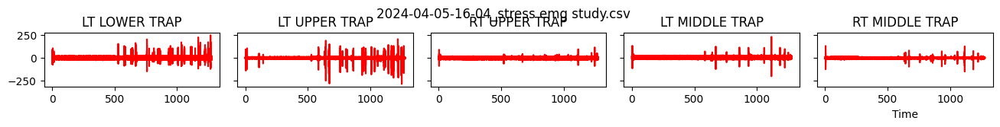

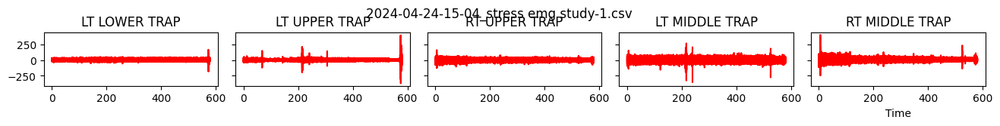

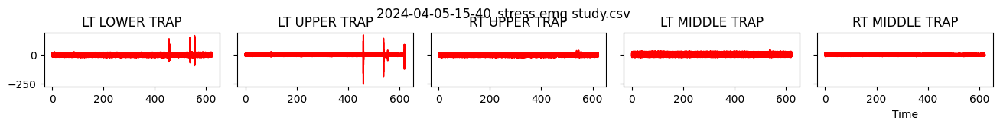

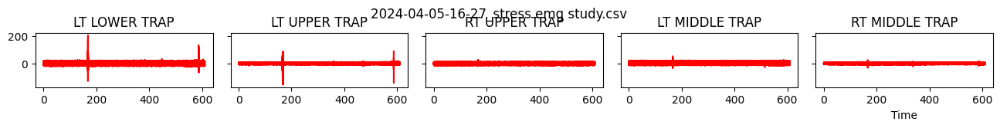

In [ ]:
c1=c
c1.plot()
c1.export_csv(['task_unprocessed','rest_unprocessed','recovery_unprocessed','task_unprocessed2','rest_unprocessed2','recovery_unprocessed2'])

Applying DC offset removal...


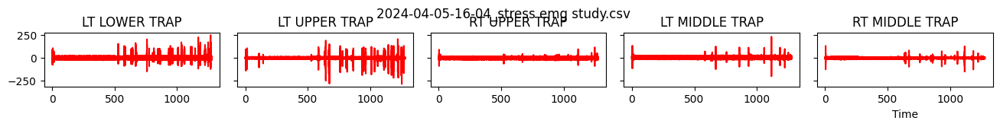

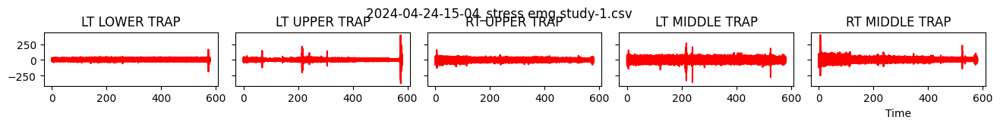

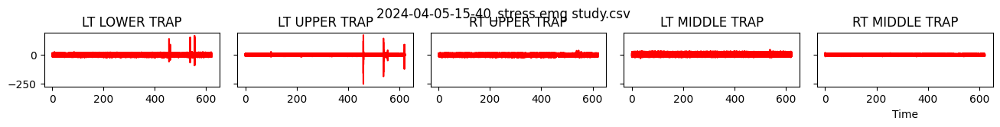

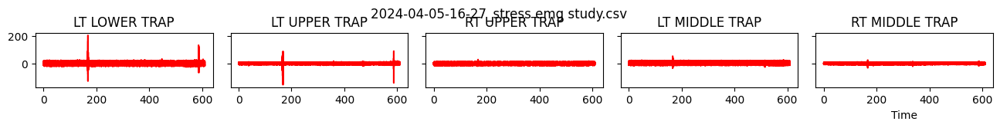

Applying bandpass filtering...


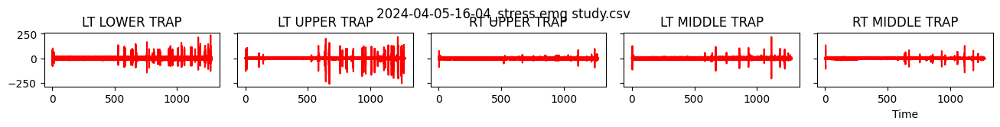

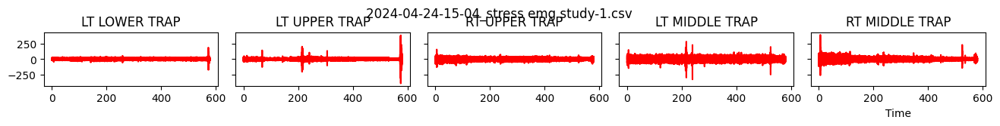

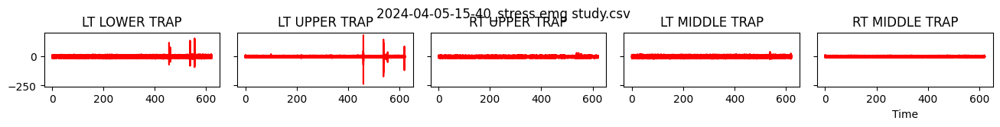

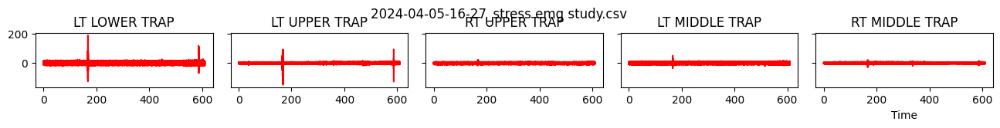

Applying full wave rectification...


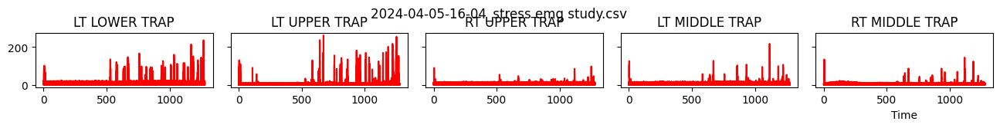

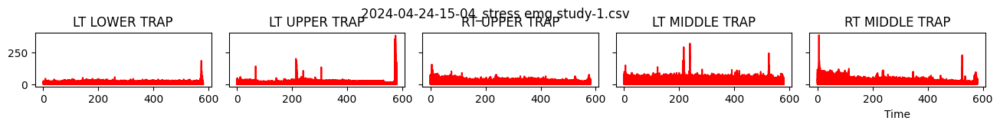

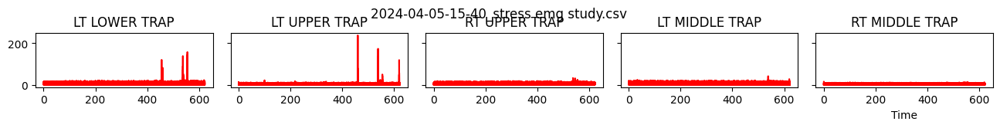

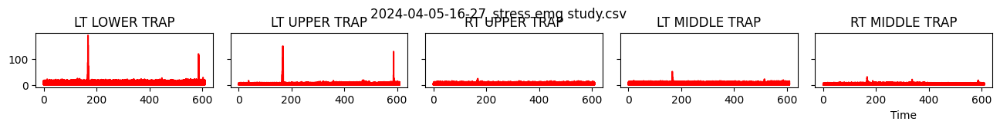

Applying end frame cutting...


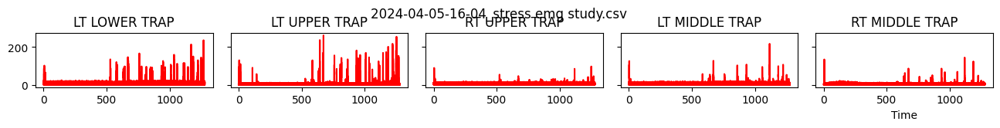

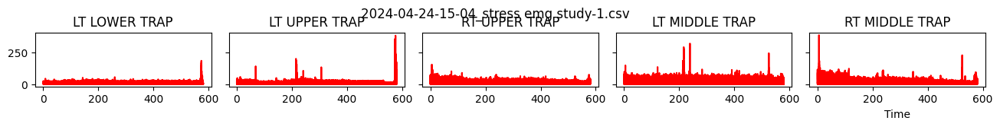

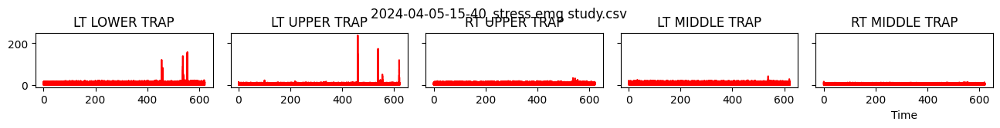

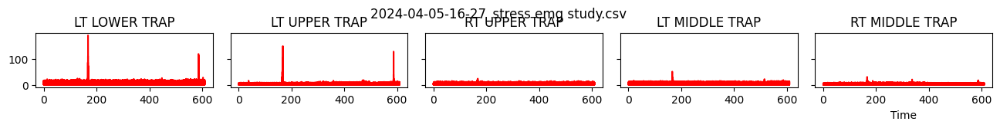

Calculating max amplitude for normalization...
Max Amplitude: [236.39927327 384.79383724 154.99652208 321.7991377  388.35358489]
Applying amplitude normalization...


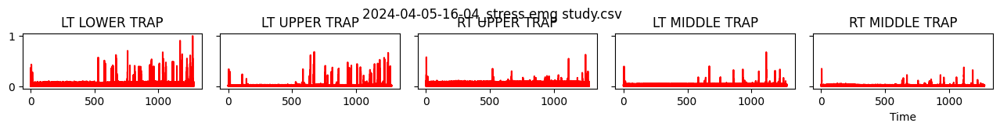

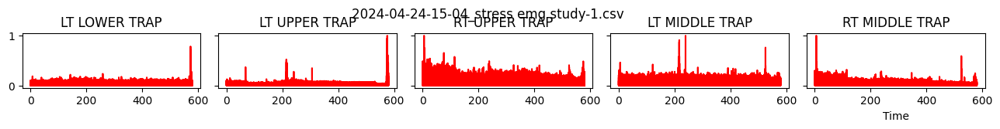

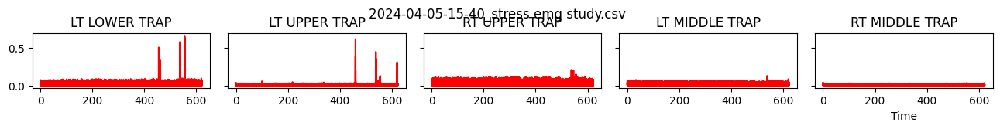

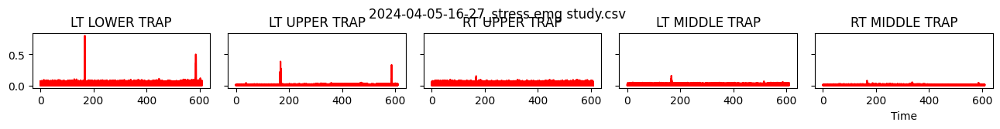

In [ ]:
# Step-by-step signal processing
print("Applying DC offset removal...")
c.apply_dc_offset_remover()
c.plot()

print("Applying bandpass filtering...")
c.apply_bandpass_filter(bf_order=4, bf_cutoff_fq_lo=20, bf_cutoff_fq_hi=500)
c.plot()

print("Applying full wave rectification...")
c.apply_full_wave_rectifier()
c.plot()

# print("Applying linear envelope...")
# c.apply_linear_envelope(le_order=4, le_cutoff_fq=6)
# c.plot()

print("Applying end frame cutting...")
c.apply_end_frame_cutter(n_end_frames=30)
c.plot()

print("Calculating max amplitude for normalization...")
max_amplitude = c.find_max_amplitude_of_each_channel_across_trials()
print('Max Amplitude:', max_amplitude)

print("Applying amplitude normalization...")
c.apply_amplitude_normalizer(max_amplitude)
c.plot()

In [ ]:
c.export_csv(r'process.csv')

In [ ]:
df_recovery=pd.read_csv('/content/o')
df_recovery.dtypes

,0
Timestamp,float64
LT LOWER TRAP,float64
LT UPPER TRAP,float64
RT UPPER TRAP,float64
LT MIDDLE TRAP,float64
RT MIDDLE TRAP,float64


In [ ]:
df_resting=pd.read_csv('/content/p')
df_resting.dtypes

,0
Timestamp,float64
LT LOWER TRAP,float64
LT UPPER TRAP,float64
RT UPPER TRAP,float64
LT MIDDLE TRAP,float64
RT MIDDLE TRAP,float64


In [ ]:
df_task=pd.read_csv('/content/r')
df_task.dtypes

,0
Timestamp,float64
LT LOWER TRAP,float64
LT UPPER TRAP,float64
RT UPPER TRAP,float64
LT MIDDLE TRAP,float64
RT MIDDLE TRAP,float64


In [ ]:
df_resting_unprocessed=pd.read_csv('/content/rest_unprocessed')
df_resting_unprocessed.dtypes

,0
Timestamp,float64
LT LOWER TRAP,float64
LT UPPER TRAP,float64
RT UPPER TRAP,float64
LT MIDDLE TRAP,float64
RT MIDDLE TRAP,float64


In [ ]:
# df_resting_unprocessed2=pd.read_csv('/content/rest_unprocessed2')
# df_resting_unprocessed2.dtypes

In [ ]:
df_task_unprocessed=pd.read_csv('/content/task_unprocessed')
df_task_unprocessed.dtypes

,0
Timestamp,float64
LT LOWER TRAP,float64
LT UPPER TRAP,float64
RT UPPER TRAP,float64
LT MIDDLE TRAP,float64
RT MIDDLE TRAP,float64


In [ ]:
df_recovery_unprocessed=pd.read_csv('/content/recovery_unprocessed')
df_recovery_unprocessed.dtypes

,0
Timestamp,float64
LT LOWER TRAP,float64
LT UPPER TRAP,float64
RT UPPER TRAP,float64
LT MIDDLE TRAP,float64
RT MIDDLE TRAP,float64


In [ ]:
import plotly.graph_objects as go
def plot_emg_data(df, title):
    # Check if DataFrame is not empty to prevent plotting errors
    if df.empty:
        print(f"No data to plot for {title}.")
        return

    # Downsample the data by selecting every 100th row
    # Ensure the DataFrame has more than 100 rows to downsample
    if len(df) > 100:
        downsampled_df = df.iloc[::100, :]
    else:
        downsampled_df = df

    # Create a Plotly figure
    fig = go.Figure()

    # Add a line trace for each EMG signal column, excluding 'Timestamp'
    for column in downsampled_df.columns:
        if column != 'Timestamp':
            fig.add_trace(go.Scatter(
                x=downsampled_df['Timestamp'],
                y=downsampled_df[column],
                mode='lines',
                name=column
            ))

    # Update the plot layout
    fig.update_layout(
        title=title,
        xaxis_title='Timestamp (s)',
        yaxis_title='EMG Signal',
        legend_title='Muscle',
        template='plotly_dark'
    )

    # Display the plot
    fig.show()

# Assuming df_task_unprocessed is already loaded and has a 'Timestamp' column
# Before filtering, ensure the 'Timestamp' column is numeric and sorted
if 'Timestamp' in df_task_unprocessed.columns:
    df_task_unprocessed['Timestamp'] = pd.to_numeric(df_task_unprocessed['Timestamp'], errors='coerce')
    df_task_unprocessed.sort_values('Timestamp', inplace=True)

    # Filtering for Task A (120 sec to 540 sec)
    df_task_A = df_task_unprocessed[(df_task_unprocessed['Timestamp'] >= 120) & (df_task_unprocessed['Timestamp'] <= 540)]

    # Filtering for Task B (700 sec to 1200 sec)
    df_task_B = df_task_unprocessed[(df_task_unprocessed['Timestamp'] >= 700) & (df_task_unprocessed['Timestamp'] <= 1200)]

    # Plot data for Task A and Task B
    plot_emg_data(df_task_A, "EMG Data for Task A")
    plot_emg_data(df_task_B, "EMG Data for Task B")

    # Optionally, save the data frames to CSV files for further use
    df_task_A.to_csv('task_A_unprocessed.csv', index=False)
    df_task_B.to_csv('task_B_unprocessed.csv', index=False)
else:
    print("Error: 'Timestamp' column not found in the dataframe.")


In [ ]:
df_recovery_unprocessed=pd.read_csv('/content/recovery_unprocessed')
df_recovery_unprocessed.dtypes

In [ ]:
# df_recovery_unprocessed1=pd.read_csv('/content/recovery_unprocessed1')
# df_recovery_unprocessed1.dtypes

In [ ]:
!pip install plotly

In [ ]:
import plotly.graph_objects as go
import pandas as pd
import numpy as np

In [ ]:
downsampled_task = df_task.iloc[::100, :]
downsampled_recovery = df_recovery.iloc[::100, :]
downsampled_resting = df_resting.iloc[::100, :]
downsampled_resting_unprocessed = df_resting_unprocessed.iloc[::100, :]
downsampled_recovery_unprocessed = df_recovery_unprocessed.iloc[::100, :]
downsampled_task_unprocessed = df_task_unprocessed.iloc[::100, :]
# Create a Plotly line plot
fig = go.Figure()
# List of muscles to plot
muscles = ['LT LOWER TRAP', 'LT UPPER TRAP', 'RT UPPER TRAP', 'LT MIDDLE TRAP', 'RT MIDDLE TRAP']

# Data dictionaries, assuming they are defined as per your previous code
data_sets = {
    'Task': {
        'Processed': downsampled_task,
        'Unprocessed': downsampled_task_unprocessed
    },
    'Recovery': {
        'Processed': downsampled_recovery,
        'Unprocessed': downsampled_recovery_unprocessed
    },
    'Resting': {
        'Processed': downsampled_resting,
        'Unprocessed': downsampled_resting_unprocessed
    }
}
color_palette = [
    '#FF5733',  # Red
    '#33FF57',  # Green
    '#3357FF',  # Blue
    '#FFFF33',  # Yellow
    '#FF33FF',  # Magenta
    '#33FFFF',  # Cyan
    '#FF914D',  # Orange
    '#914DFF',  # Purple
    '#4DFF91',  # Spring Green
    '#000000',  # Black
    '#FFFFFF',  # White
    '#FFD700',  # Gold
    '#808080',  # Grey
    '#8B4513',  # Saddle Brown
    '#FF6347',  # Tomato
    '#40E0D0',  # Turquoise
    '#EE82EE',  # Violet
    '#A0522D',  # Sienna
    '#6A5ACD',  # Slate Blue
    '#708090',  # Slate Grey
    '#00FF7F',  # Spring Green
    '#4682B4',  # Steel Blue
    '#D2B48C',  # Tan
    '#008080',  # Teal
    '#D8BFD8',  # Thistle
    '#FF4500',  # Orange Red
    '#DA70D6',  # Orchid
    '#EEE8AA',  # Pale Golden Rod
    '#98FB98',  # Pale Green
    '#AFEEEE'   # Pale Turquoise
]

# Adding traces for each muscle, condition and data type
color_index = 0
for condition, datasets in data_sets.items():
    for data_type, data in datasets.items():
        for muscle in muscles:
            fig.add_trace(go.Scatter(
                x=data['Timestamp'],
                y=data[muscle],
                mode='lines',
                name=f'{muscle} - {condition} ({data_type})',
                line=dict(color=color_palette[color_index])
            ))
            color_index = (color_index + 1) % len(color_palette)  # Cycle through colors if needed

# Update layout if necessary

# Update layout
fig.update_layout(
    title='Multiple Dataframes Line Plot',
    xaxis_title='Timestamp',
    yaxis_title='Value',
    legend_title='Features',
    template='plotly_dark'
)

# Show plot
fig.show()

# **cutting frames **

In [ ]:

# Filter data for specific time frames
df_resting_unprocessed_cut = df_resting_unprocessed[(df_resting_unprocessed['Timestamp'] >= 120) & (df_resting_unprocessed['Timestamp'] <= 600)]
df_recovery_unprocessed_cut = df_recovery_unprocessed[(df_recovery_unprocessed['Timestamp'] >= 120) & (df_recovery_unprocessed['Timestamp'] <= 600)]
df_task_unprocessed_cut = df_task_unprocessed[(df_task_unprocessed['Timestamp'] >= 120) & (df_task_unprocessed['Timestamp'] <= 1200)]

# Display to verify
print("Resting Unprocessed Cut:")
print(df_resting_unprocessed_cut.head())
print("Recovery Unprocessed Cut:")
print(df_recovery_unprocessed_cut.head())
print("Task Unprocessed Cut:")
print(df_task_unprocessed_cut.head())

Resting Unprocessed Cut:
        Timestamp  LT LOWER TRAP  LT UPPER TRAP  RT UPPER TRAP  \
240000   120.0000     -10.532612      -2.878240      16.538748   
240001   120.0005      -8.089942      -4.089499       8.296073   
240002   120.0010      -5.036605      -3.489866      -0.247572   
240003   120.0015      -2.902071      -2.266614      -1.776690   
240004   120.0020      -3.512738      -2.878240       0.058252   

        LT MIDDLE TRAP  RT MIDDLE TRAP  
240000       21.412462        9.696075  
240001       16.535717        6.944982  
240002       11.045342       10.906556  
240003        9.204452       17.020096  
240004        9.204452       15.491712  
Recovery Unprocessed Cut:
        Timestamp  LT LOWER TRAP  LT UPPER TRAP  RT UPPER TRAP  \
240000   120.0000      -3.988763       3.352499      -2.769583   
240001   120.0005      -3.071806       1.828636      -4.906020   
240002   120.0010      -3.377458       1.828636      -5.211716   
240003   120.0015      -4.594973       2.4

In [ ]:

# Filter data for specific time frames
df_resting_unprocessed_cut = df_resting_unprocessed[(df_resting_unprocessed['Timestamp'] >= 120) & (df_resting_unprocessed['Timestamp'] <= 600)]
df_recovery_unprocessed_cut = df_recovery_unprocessed[(df_recovery_unprocessed['Timestamp'] >= 120) & (df_recovery_unprocessed['Timestamp'] <= 600)]
df_task_unprocessed_cut = df_task_unprocessed[(df_task_unprocessed['Timestamp'] >= 120) & (df_task_unprocessed['Timestamp'] <= 1200)]
# df_resting_unprocessed1_cut = df_resting_unprocessed1[(df_resting_unprocessed1['Timestamp'] >= 120) & (df_resting_unprocessed1['Timestamp'] <= 600)]
# df_recovery_unprocessed1_cut = df_recovery_unprocessed1[(df_recovery_unprocessed1['Timestamp'] >= 120) & (df_recovery_unprocessed1['Timestamp'] <= 600)]
# df_task_unprocessed_cut1 = df_task_unprocessed1[(df_task_unprocessed1['Timestamp'] >= 120) & (df_task_unprocessed1['Timestamp'] <= 1200)]

# Optionally, save or further process these DataFrames
# df_resting_unprocessed_cut.to_csv('resting_unprocessed_cut.csv', index=False)
# df_recovery_unprocessed_cut.to_csv('recovery_unprocessed_cut.csv', index=False)
# df_task_unprocessed_cut.to_csv('task_unprocessed_cut.csv', index=False)

# Display to verify
print("Resting Unprocessed Cut:")
print(df_resting_unprocessed_cut.head())
print("Recovery Unprocessed Cut:")
print(df_recovery_unprocessed_cut.head())
print("Task Unprocessed Cut:")
print(df_task_unprocessed_cut.head())

Resting Unprocessed Cut:
        Timestamp  LT LOWER TRAP  LT UPPER TRAP  RT UPPER TRAP  \
240000   120.0000     -10.532612      -2.878240      16.538748   
240001   120.0005      -8.089942      -4.089499       8.296073   
240002   120.0010      -5.036605      -3.489866      -0.247572   
240003   120.0015      -2.902071      -2.266614      -1.776690   
240004   120.0020      -3.512738      -2.878240       0.058252   

        LT MIDDLE TRAP  RT MIDDLE TRAP  
240000       21.412462        9.696075  
240001       16.535717        6.944982  
240002       11.045342       10.906556  
240003        9.204452       17.020096  
240004        9.204452       15.491712  
Recovery Unprocessed Cut:
        Timestamp  LT LOWER TRAP  LT UPPER TRAP  RT UPPER TRAP  \
240000   120.0000      -3.988763       3.352499      -2.769583   
240001   120.0005      -3.071806       1.828636      -4.906020   
240002   120.0010      -3.377458       1.828636      -5.211716   
240003   120.0015      -4.594973       2.4

In [ ]:
import plotly.graph_objects as go

def plot_unprocessed_emg_data(data_frames, titles):
    # Initialize the Plotly figure
    fig = go.Figure()

    color_palette = [
        '#FF5733',  # Red for Resting
        '#33FF57',  # Green for Recovery
        '#3357FF',  # Blue for Task
    ]

    # Define a simple downsampling rate to prevent overly dense plots
    downsample_rate = 100

    # Iterate over the provided data frames and their respective titles
    for df, title, color in zip(data_frames, titles, color_palette):
        # Downsample the data frame
        downsampled_df = df.iloc[::downsample_rate, :]

        # Loop through each column except 'Timestamp' and plot
        for column in downsampled_df.columns:
            if column != 'Timestamp':
                fig.add_trace(go.Scatter(
                    x=downsampled_df['Timestamp'],
                    y=downsampled_df[column],
                    mode='lines',
                    name=f'{title} - {column}',
                    line=dict(color=color)
                ))

    # Update layout to add titles and adjust other settings
    fig.update_layout(
        title='Unprocessed EMG Data Across Different Conditions',
        xaxis_title='Timestamp (s)',
        yaxis_title='EMG Signal Value',
        legend_title='Muscles/Conditions',
        template='plotly_dark'
    )

    # Display the interactive plot
    fig.show()

# Data frames corresponding to resting, recovery, and task conditions
data_frames = [df_resting_unprocessed_cut, df_recovery_unprocessed_cut, df_task_unprocessed_cut]
titles = ["Resting Unprocessed EMG", "Recovery Unprocessed EMG", "Task Unprocessed EMG"]

# Call the plotting function
plot_unprocessed_emg_data(data_frames, titles)


In [ ]:
def plot_all_unprocessed_data(df_rest, df_recovery, df_task_A, df_task_B):
    # Create a Plotly figure
    fig = go.Figure()

    # Define a simple function to add traces for each data segment
    def add_trace_to_plot(df, segment_label, color, dash_style='solid'):
        if df.empty:
            print(f"No data available for {segment_label}. Skipping this segment.")
            return

        # Downsample if necessary
        downsampled_df = df.iloc[::100, :] if len(df) > 100 else df

        # Add a trace for each column in the DataFrame, except 'Timestamp'
        for column in downsampled_df.columns:
            if column != 'Timestamp':
                fig.add_trace(go.Scatter(
                    x=downsampled_df['Timestamp'],
                    y=downsampled_df[column],
                    mode='lines',
                    name=f'{segment_label} - {column}',
                    line=dict(color=color, dash=dash_style)
                ))

    # Add data from each segment to the plot
    add_trace_to_plot(df_rest, 'Resting', 'blue')
    add_trace_to_plot(df_recovery, 'Recovery', 'green')
    add_trace_to_plot(df_task_A, 'Task A', 'red')
    add_trace_to_plot(df_task_B, 'Task B', 'purple', dash_style='dot')

    # Update plot layout
    fig.update_layout(
        title='Combined EMG Data Segemented ',
        xaxis_title='Timestamp (s)',
        yaxis_title='EMG Signal',
        legend_title='Segment and Muscle',
        template='plotly_dark'
    )

    # Display the plot
    fig.show()

# Assuming df_rest, df_recovery, df_task_A, df_task_B are already defined and properly filtered
plot_all_unprocessed_data(df_resting_unprocessed_cut, df_recovery_unprocessed_cut, df_task_A, df_task_B)

In [ ]:
downsampled_df = df_resting.iloc[::100, :]

# Create a Plotly line plot
fig = go.Figure()

# Add traces for each column (downsampled)
fig.add_trace(go.Scatter(x=downsampled_df['Timestamp'], y=downsampled_df['LT LOWER TRAP'], mode='lines', name='LT LOWER TRAP'))

# Update layout
fig.update_layout(
    title='task',
    xaxis_title='Timestamp',
    yaxis_title='Value',
    legend_title='Features',
    template='plotly'
)

# Show plot
fig.show()

In [ ]:
downsampled_df = df_task.iloc[::100, :]

# Create a Plotly line plot
fig = go.Figure()

# Add traces for each column (downsampled)
fig.add_trace(go.Scatter(x=downsampled_df['Timestamp'], y=downsampled_df['LT LOWER TRAP'], mode='lines', name='LT LOWER TRAP'))

# Update layout
fig.update_layout(
    title='recovery',
    xaxis_title='Timestamp',
    yaxis_title='Value',
    legend_title='Features',
    template='plotly'
)

# Show plot
fig.show()

In [ ]:
downsampled_df = df_recovery.iloc[::100, :]

# Create a Plotly line plot
fig = go.Figure()

# Add traces for each column (downsampled)
fig.add_trace(go.Scatter(x=downsampled_df['Timestamp'], y=downsampled_df['LT LOWER TRAP'], mode='lines', name='LT LOWER TRAP'))

# Update layout
fig.update_layout(
    title='resting',
    xaxis_title='Timestamp',
    yaxis_title='Value',
    legend_title='Features',
    template='plotly'
)

# Show plot
fig.show()

In [ ]:
# from matplotlib import pyplot as plt
# import seaborn as sns
# def _plot_series(series, series_name, series_index=0):
#   palette = list(sns.palettes.mpl_palette('Dark2'))
#   xs = series['Timestamp']
#   ys = series['LT LOWER TRAP']

#   plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

# fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
# df_sorted = df.sort_values('Timestamp', ascending=True)
# _plot_series(df_sorted, '')
# sns.despine(fig=fig, ax=ax)
# plt.xlabel('Timestamp')
# _ = plt.ylabel('LT LOWER TRAP')

In [ ]:
# # Ensure the Timestamp column is in datetime format
# import pandas as pd
# import numpy as np
# import matplotlib.pyplot as plt
# from ipywidgets import interact
# import ipywidgets as widgets
16
# df['Timestamp'] = pd.to_datetime(df['Timestamp'])

# # Function to plot with zoom
# def plot_zoom(xlim):
#     plt.figure(figsize=(10, 6))
#     plt.plot(df['Timestamp'], df['LT LOWER TRAP'], label='LT LOWER TRAP')
#     plt.title('Line Plot of Features')
#     plt.xlabel('Timestamp')
#     plt.ylabel('LT LOWER TRAP')
#     plt.legend()
#     plt.xlim(df['Timestamp'].iloc[0], df['Timestamp'].iloc[0] + pd.Timedelta(days=xlim))
#     plt.show()

# # Slider widget for zoom
# interact(plot_zoom, xlim=widgets.IntSlider(min=1, max=len(df), step=1, value=len(df)))


In [ ]:
import numpy as np

# for i in np.arange(0, 10000000, 0.001):
#     print(i)

# **cnn**

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import tensorflow
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.decomposition import PCA
from sklearn.metrics import classification_report
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dropout, Flatten, Dense, Reshape

In [ ]:
def segment_data(data, window_size, step_size):
    num_segments = (len(data) - window_size) // step_size + 1
    segments = []
    for i in range(num_segments):
        start = i * step_size
        end = start + window_size
        segments.append(data[start:end])
    return np.array(segments)


In [ ]:


#     return segments, labels
def label_segments(resting_segments, task_a_segments, task_b_segments, recovery_segments):
    # Create labels using string names for each category
    resting_labels = np.array(['rest'] * len(resting_segments))
    task_a_labels = np.array(['stress 1'] * len(task_a_segments))
    task_b_labels = np.array(['stress 2'] * len(task_b_segments))
    recovery_labels = np.array(['recovery'] * len(recovery_segments))

    # Concatenate all segment arrays
    segments = np.concatenate((resting_segments, task_a_segments, task_b_segments, recovery_segments), axis=0)
    labels = np.concatenate((resting_labels, task_a_labels, task_b_labels, recovery_labels), axis=0)

    # Define a mapping from string labels to integers
    label_mapping = {'rest': 0, 'stress 1': 1, 'stress 2': 2, 'recovery': 3}

    # Convert labels to integers using the mapping
    labels = np.vectorize(label_mapping.get)(labels)

    return segments, labels


In [ ]:
def label_segments(resting_segments, task_a_segments, task_b_segments, recovery_segments):
    # Create labels using string names for each category
    resting_labels = np.array(['rest'] * len(resting_segments))
    task_a_labels = np.array(['stress 1'] * len(task_a_segments))
    # Handle the case where taskB_segments might be empty
    if task_b_segments.size > 0:
        task_b_labels = np.array(['stress 2'] * len(task_b_segments))
    else:
        task_b_labels = np.array([])  # Empty array for labels if no taskB segments
    recovery_labels = np.array(['recovery'] * len(recovery_segments))

    # Concatenate all segment arrays, handling the potential empty taskB_segments
    if task_b_segments.size > 0:
        segments = np.concatenate((resting_segments, task_a_segments, task_b_segments, recovery_segments), axis=0)
        labels = np.concatenate((resting_labels, task_a_labels, task_b_labels, recovery_labels), axis=0)
    else:
        segments = np.concatenate((resting_segments, task_a_segments, recovery_segments), axis=0)
        labels = np.concatenate((resting_labels, task_a_labels, recovery_labels), axis=0)

    # Define a mapping from string labels to integers
    label_mapping = {'rest': 0, 'stress 1': 1, 'stress 2': 2, 'recovery': 3}

    # Convert labels to integers using the mapping
    labels = np.vectorize(label_mapping.get)(labels)

    return segments, labels

In [ ]:
gpus = tensorflow.config.list_physical_devices('GPU')
print(gpus)


[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [ ]:
# Load your data into pandas data frames
resting_df = pd.read_csv('/content/rest_unprocessed')
taskA_df = pd.read_csv('/content/task_A_unprocessed.csv')
taskB_df = pd.read_csv('/content/task_B_unprocessed.csv')
recovery_df = pd.read_csv('/content/recovery_unprocessed')
resting_df=resting_df[['LT LOWER TRAP', 'LT UPPER TRAP', 'RT UPPER TRAP', 'RT MIDDLE TRAP','LT MIDDLE TRAP']]
recovery_df=recovery_df[['LT LOWER TRAP', 'LT UPPER TRAP', 'RT UPPER TRAP', 'RT MIDDLE TRAP','LT MIDDLE TRAP']]
taskA_df=taskA_df[['LT LOWER TRAP', 'LT UPPER TRAP', 'RT UPPER TRAP', 'RT MIDDLE TRAP','LT MIDDLE TRAP']]
taskB_df=taskB_df[['LT LOWER TRAP', 'LT UPPER TRAP', 'RT UPPER TRAP', 'RT MIDDLE TRAP','LT MIDDLE TRAP']]
resting_df

FileNotFoundError: [Errno 2] No such file or directory: '/content/rest_unprocessed'

In [ ]:
# Parameters
window_size = 160
step_size = 80

# Segment the data
resting_segments = segment_data(resting_df.values, window_size, step_size)
taskA_segments = segment_data(taskA_df.values, window_size, step_size)
taskB_segments = segment_data(taskB_df.values, window_size, step_size)
recovery_segments = segment_data(recovery_df.values, window_size, step_size)

# Label the segments
segments, labels = label_segments(resting_segments, taskA_segments,taskB_segments, recovery_segments)


NameError: name 'segment_data' is not defined

In [ ]:
# # Assuming 'segments' and 'labels' are already defined
print("Original segments shape:", segments.shape)

scaler = StandardScaler()
# # # Reshape segments assuming the data is structured as (samples, window_size, num_channels)
segments = scaler.fit_transform(segments.reshape(-1, segments.shape[-1])).reshape(segments.shape)
print("Normalized segments shape:", segments.shape)

# # Split the data into training, validation, and test sets
# x_train, x_temp, y_train, y_temp = train_test_split(segments, labels, test_size=0.3, random_state=42)
# x_val, x_test, y_val, y_test = train_test_split(x_temp, y_temp, test_size=0.5, random_state=42)

# print("x_train shape pre-reshape:", x_train.shape)
# print("x_val shape pre-reshape:", x_val.shape)
# print("x_test shape pre-reshape:", x_test.shape)

# # Constants for reshaping

# num_channels = 5   # The actual number of channels in the data, corrected to 6

# # Reshape data to include the channels dimension for CNN
# try:
#     x_train = x_train.reshape(x_train.shape[0], window_size, num_channels, 1)
#     x_val = x_val.reshape(x_val.shape[0], window_size, num_channels, 1)
#     x_test = x_test.reshape(x_test.shape[0], window_size, num_channels, 1)
# except ValueError as e:
#     print("Reshape error:", e)
#     print("Ensure that the product of window_size, num_channels, and the additional 1 channel matches the total elements per sample.")

# print("x_train shape post-reshape:", x_train.shape)
# print("x_val shape post-reshape:", x_val.shape)
# print("x_test shape post-reshape:", x_test.shape)


# One-hot encode the labels
labels_one_hot = tf.keras.utils.to_categorical(labels,4)

# Split the data
x_train, x_temp, y_train, y_temp = train_test_split(segments, labels_one_hot, test_size=0.3, random_state=42)
x_val, x_test, y_val, y_test = train_test_split(x_temp, y_temp, test_size=0.5, random_state=42)

num_channels = 5   # The actual number of channels in the data, corrected to 6
print("x_train shape pre-reshape:", x_train.shape)
print("x_val shape pre-reshape:", x_val.shape)
print("x_test shape pre-reshape:", x_test.shape)
# Reshape data to include the channels dimension for CNN
try:
    x_train = x_train.reshape(x_train.shape[0], window_size, num_channels, 1)
    x_val = x_val.reshape(x_val.shape[0], window_size, num_channels, 1)
    x_test = x_test.reshape(x_test.shape[0], window_size, num_channels, 1)
except ValueError as e:
    print("Reshape error:", e)
    print("Ensure that the product of window_size, num_channels, and the additional 1 channel matches the total elements per sample.")

print("x_train shape post-reshape:", x_train.shape)
print("x_val shape post-reshape:", x_val.shape)
print("x_test shape post-reshape:", x_test.shape)


Original segments shape: (52739, 160, 5)
Normalized segments shape: (52739, 160, 5)
x_train shape pre-reshape: (36917, 160, 5)
x_val shape pre-reshape: (7911, 160, 5)
x_test shape pre-reshape: (7911, 160, 5)
x_train shape post-reshape: (36917, 160, 5, 1)
x_val shape post-reshape: (7911, 160, 5, 1)
x_test shape post-reshape: (7911, 160, 5, 1)


In [ ]:
import tensorflow as tf

# Initialize TPU Cluster Resolver
# Replace 'your_tpu_name' with the actual name of your TPU instance
resolver = tf.distribute.cluster_resolver.TPUClusterResolver(tpu='TPU v2')
tf.config.experimental_connect_to_cluster(resolver)
tf.config.experimental_set_virtual_device_configuration(
tf.config.list_physical_devices('TPU')[0],
  [tf.config.experimental.VirtualDeviceConfiguration(memory_limit=8192)]
  )
tf.tpu.experimental.initialize_tpu_system(resolver)
strategy = tf.distribute.TPUStrategy(resolver)
print('TPU initialized successfully.')



HTTPError: HTTP Error 404: Not Found

In [ ]:
import tensorflow as tf

# This part should now work after enabling TPU and restarting the runtime
resolver = tf.distribute.cluster_resolver.TPUClusterResolver()  # No need to specify 'tpu' if in Colab TPU environment
tf.config.experimental_connect_to_cluster(resolver)
tf.tpu.experimental.initialize_tpu_system(resolver)
strategy = tf.distribute.TPUStrategy(resolver)
print('TPU initialized successfully.')

TPU initialized successfully.


In [ ]:
# #good cnn

# model = models.Sequential([
#     layers.Conv2D(256, (3, 3), padding='same', activation='relu', input_shape=(window_size, 5, 1)),
#     layers.MaxPooling2D((2, 2), padding='same'),  # Use padding='same' here
#     layers.Dropout(0.45),

#     layers.Conv2D(128, (3, 3), padding='same', activation='relu'),
#     layers.MaxPooling2D((2, 2), padding='same'),  # Use padding='same' here
#     layers.Dropout(0.45),

#     layers.Conv2D(64, (3, 3), padding='same', activation='relu'),
#     layers.MaxPooling2D((2, 2), padding='same'),  # Use padding='same' here

#     layers.Flatten(),
#     layers.Dense(128, activation='relu'),
#     layers.Dense(32, activation='relu'),
#     layers.Dense(4, activation='softmax')  # Assume 4 classes
# ])

# # Compile the model
# model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
# # Show the model summary to verify the output sizes at each layer
# model.summary()

# CNN Model with ResNets applied

from tensorflow.keras import layers, models, optimizers

# #residual block
# def residual_block(x, filters, kernel_size=3, stride=1):
#     shortcut = x
#     x = layers.Conv2D(filters, kernel_size, strides=stride, padding='same', activation='relu')(x)
#     x = layers.Conv2D(filters, kernel_size, strides=stride, padding='same')(x)
#     x = layers.Add()([x, shortcut])
#     x = layers.Activation('relu')(x)
#     return x

#residual block
def residual_block(x, filters, kernel_size=3, stride=1):
    shortcut = layers.Conv2D(filters, (1, 1), strides=stride, padding='same')(x) # Adjust the number of filters in the shortcut
    x = layers.Conv2D(filters, kernel_size, strides=stride, padding='same', activation='relu')(x)
    x = layers.Conv2D(filters, kernel_size, strides=stride, padding='same')(x)
    x = layers.Add()([x, shortcut])
    x = layers.Activation('relu')(x)
    return x

#CNN model
input_shape = (window_size, num_channels, 1)
inputs = layers.Input(shape=input_shape)


x = layers.Conv2D(256, (3, 3), padding='same', activation='relu')(inputs)
x = layers.MaxPooling2D((2, 2), padding='same')(x)
x = layers.Dropout(0.45)(x)

x = residual_block(x, 256)
x = layers.MaxPooling2D((2, 2), padding='same')(x)
x = layers.Dropout(0.45)(x)


x = residual_block(x, 128)
x = layers.MaxPooling2D((2, 2), padding='same')(x)
x = layers.Dropout(0.45)(x)


x = residual_block(x, 64)
x = layers.MaxPooling2D((2, 2), padding='same')(x)
x = layers.Dropout(0.45)(x)


x = layers.Conv2D(64, (3, 3), padding='same', activation='relu')(x)
x = layers.MaxPooling2D((2, 2), padding='same')(x)
x = layers.Dropout(0.45)(x)


x = layers.Flatten()(x)
x = layers.Dense(128, activation='relu')(x)
x = layers.Dropout(0.45)(x)
x = layers.Dense(64, activation='relu')(x)
x = layers.Dropout(0.45)(x)
x = layers.Dense(32, activation='relu')(x)
x = layers.Dense(4, activation='softmax')(x)  # Assume 4 classes


model = models.Model(inputs=inputs, outputs=x)


model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])


model.summary()



# import tensorflow as tf
# from tensorflow.keras import layers, models, optimizers, callbacks
# import datetime

# # Enable mixed precision
# tf.keras.mixed_precision.set_global_policy('mixed_float16')

# # Residual block
# def residual_block(x, filters, kernel_size=3, stride=1):
#     shortcut = layers.Conv2D(filters, (1, 1), strides=stride, padding='same')(x) # Adjust the number of filters in the shortcut
#     x = layers.Conv2D(filters, kernel_size, strides=stride, padding='same', activation='relu')(x)
#     x = layers.Conv2D(filters, kernel_size, padding='same')(x)
#     x = layers.Add()([x, shortcut])
#     x = layers.Activation('relu')(x)
#     return x

# # CNN model
# input_shape = (window_size, num_channels, 1)
# inputs = layers.Input(shape=input_shape)

# x = layers.Conv2D(64, (3, 3), padding='same', activation='relu')(inputs) # Reduced number of filters
# x = layers.MaxPooling2D((2, 2), padding='same')(x)
# x = layers.Dropout(0.45)(x)

# x = residual_block(x, 64) # Reduced number of filters
# x = layers.MaxPooling2D((2, 2), padding='same')(x)
# x = layers.Dropout(0.45)(x)

# x = residual_block(x, 32) # Reduced number of filters
# x = layers.MaxPooling2D((2, 2), padding='same')(x)
# x = layers.Dropout(0.45)(x)

# x = residual_block(x, 16) # Reduced number of filters
# x = layers.MaxPooling2D((2, 2), padding='same')(x)
# x = layers.Dropout(0.45)(x)

# x = layers.Conv2D(16, (3, 3), padding='same', activation='relu')(x) # Reduced number of filters
# x = layers.MaxPooling2D((2, 2), padding='same')(x)
# x = layers.Dropout(0.45)(x)

# x = layers.Flatten()(x)
# x = layers.Dense(64, activation='relu')(x) # Reduced size of dense layers
# x = layers.Dropout(0.45)(x)
# x = layers.Dense(32, activation='relu')(x)
# x = layers.Dropout(0.45)(x)
# x = layers.Dense(16, activation='relu')(x)
# x = layers.Dense(4, activation='softmax')(x)  # Assume 4 classes

# model = models.Model(inputs=inputs, outputs=x)

# model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# # Callbacks
# log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
# tensorboard_callback = callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)
# early_stopping = callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)














NameError: name 'window_size' is not defined

In [ ]:
import tensorflow as tf
from tensorflow.keras.callbacks import EarlyStopping, TensorBoard
import datetime

# Set up TensorBoard callback
log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = TensorBoard(log_dir=log_dir, histogram_freq=1)

# Set up early stopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)

# Train the model with the callbacks
history = model.fit(
    x_train, y_train,
    epochs=20,
    batch_size=64,
    validation_data=(x_val, y_val),
    callbacks=[early_stopping, tensorboard_callback]
)

NameError: name 'model' is not defined

In [ ]:
# import numpy as np
# import tensorflow as tf
# from sklearn.model_selection import KFold
# from tensorflow.keras import layers, models

# # Assuming 'data' and 'labels' are your dataset and labels respectively
# data = np.random.rand(100, 160, 5, 1)  # Example data shape (100 samples, window size 160, 5 channels, 1 depth)
# labels = tf.keras.utils.to_categorical(np.random.randint(4, size=(100, 1)), num_classes=4)  # 4 classes

# def create_model(input_shape):
#     model = models.Sequential([
#         layers.Conv2D(256, (3, 3), padding='same', activation='relu', input_shape=input_shape),
#         layers.MaxPooling2D((2, 2), padding='same'),
#         layers.Dropout(0.45),
#         layers.Conv2D(128, (3, 3), padding='same', activation='relu'),
#         layers.MaxPooling2D((2, 2), padding='same'),
#         layers.Dropout(0.45),
#         layers.Conv2D(64, (3, 3), padding='same', activation='relu'),
#         layers.MaxPooling2D((2, 2), padding='same'),
#         layers.Flatten(),
#         layers.Dense(128, activation='relu'),
#         layers.Dense(32, activation='relu'),
#         layers.Dense(4, activation='softmax')
#     ])
#     model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
#     return model

# # Define k-fold cross validation test harness
# kfold = KFold(n_splits=5, shuffle=True, random_state=42)
# fold_no = 1
# for train, test in kfold.split(data, labels):
#     model = create_model((160, 5, 1))  # Adjust input shape based on your actual data
#     print('------------------------------------------------------------------------')
#     print(f'Training for fold {fold_no} ...')

#     # Fit data to model
#     history = model.fit(data[train], labels[train],
#                         batch_size=32,
#                         epochs=10,
#                         verbose=1,
#                         validation_data=(data[test], labels[test]))

#     # Increase fold number
#     fold_no += 1


In [ ]:
import matplotlib.pyplot as plt

# Plotting the training history for accuracy
plt.figure(figsize=(8, 6))
plt.plot(history.history['accuracy'], label='Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='lower right')
plt.show()

# Plotting the training history for loss
plt.figure(figsize=(8, 6))
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(loc='upper right')
plt.show()


In [ ]:
import numpy as np
import tensorflow as tf
from sklearn.metrics import classification_report

# Evaluate the model on the test set
test_loss, test_acc = model.evaluate(x_test, y_test)
print(f"Test Accuracy: {test_acc:.4f}")
# Predict and analyze the results
y_pred = model.predict(x_test)

# Convert probabilities to class indices
y_pred_classes = np.argmax(y_pred, axis=1)
# Ensure y_test is in the correct format if it's one-hot encoded
if y_test.shape[-1] > 1:  # Checking if y_test is one-hot encoded
    y_test_classes = np.argmax(y_test, axis=1)
else:
    y_test_classes = y_test  # Assuming y_test is already class indices
# Generate classification report
from sklearn.metrics import classification_report
print(classification_report(y_test_classes, y_pred_classes, target_names=['Rest', 'Recovery', 'Stress 1', 'Stress 2']))



In [ ]:
import numpy as np
import tensorflow as tf
from sklearn.metrics import classification_report

# Assuming you have your 'y_test' and 'y_pred' from the model predictions

# Relabel the test and prediction labels from four classes to binary classes
# Let's say:
# - 'Rest' and 'Recovery' are 'unstressed' (0)
# - 'Stress 1' and 'Stress 2' are 'stressed' (1)

# Map original multi-class labels to binary labels
def relabel_to_binary(labels):
    binary_labels = np.where((labels == 0) | (labels == 1), 0, 1)
    return binary_labels

# Ensure y_test and y_pred_classes are correctly transformed
y_test_binary = relabel_to_binary(y_test_classes)
y_pred_binary = relabel_to_binary(y_pred_classes)

# Generate binary classification report
print(classification_report(y_test_binary, y_pred_binary, target_names=['Unstressed', 'Stressed']))


In [ ]:
model.save('stress_emg_model_92')

In [ ]:
!zip -r /content/stress_emg_model_92.zip /content/stress_emg_model_92

In [ ]:
# import numpy as np
# import tensorflow as tf
# from tensorflow.keras import models, layers
# from tensorflow.keras.models import Model
# from sklearn.svm import SVC
# from sklearn.metrics import classification_report

# # # Define your CNN model architecture
# # model = models.Sequential([
# #     layers.Conv2D(256, (3, 3), padding='same', activation='relu', input_shape=(window_size, 5, 1)),
# #     layers.MaxPooling2D((2, 2), padding='same'),
# #     layers.Dropout(0.45),

# #     layers.Conv2D(128, (3, 3), padding='same', activation='relu'),
# #     layers.MaxPooling2D((2, 2), padding='same'),
# #     layers.Dropout(0.45),

# #     layers.Conv2D(64, (3, 3), padding='same', activation='relu'),
# #     layers.MaxPooling2D((2, 2), padding='same'),

# #     layers.Flatten(),
# #     layers.Dense(128, activation='relu'),
# #     layers.Dense(32, activation='relu'),
# #     layers.Dense(4, activation='softmax')  # Assume 4 classes
# # ])

# # # Compile the model
# # model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# # # Show the model summary to verify the output sizes at each layer
# # model.summary()

# # # Assuming x_train, y_train, x_test, y_test are defined
# # # Train the model
# # model.fit(x_train, y_train, epochs=10, batch_size=32, validation_data=(x_test, y_test))

# # # Save the model
# # model.save('path_to_saved_model/my_model')

# # # Load the model
# # model = tf.keras.models.load_model('path_to_saved_model/my_model')

# # Modify the model to output features from the flatten layer
# layer_name = 'flatten_2'
# feature_extractor = Model(inputs=model.input, outputs=model.get_layer(layer_name).output)

# # Extract features
# x_train_features = feature_extractor.predict(x_train)
# x_test_features = feature_extractor.predict(x_test)

# # Ensure y_train and y_test are in the correct format
# if y_train.shape[-1] > 1:  # Checking if y_train is one-hot encoded
#     y_train_classes = np.argmax(y_train, axis=1)
# else:
#     y_train_classes = y_train  # Assuming y_train is already class indices

# if y_test.shape[-1] > 1:  # Checking if y_test is one-hot encoded
#     y_test_classes = np.argmax(y_test, axis=1)
# else:
#     y_test_classes = y_test  # Assuming y_test is already class indices

# # Initialize and train the SVM model
# svm_model = SVC(kernel='linear')
# svm_model.fit(x_train_features, y_train_classes)

# # Predict and evaluate the results
# y_test_pred = svm_model.predict(x_test_features)

# # Generate classification report
# print(classification_report(y_test_classes, y_test_pred, target_names=['Rest', 'Recovery', 'Stress 1', 'Stress 2']))


In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs